<a href="https://colab.research.google.com/github/Bhavyasree151/225003193/blob/main/Copy_of_objdetection1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK./root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1
# /content/labels_with_dont_care
import kagglehub
klemenko_kitti_dataset_path = kagglehub.dataset_download('klemenko/kitti-dataset')

print('Data source import complete.')


Data source import complete.


In [5]:
!pip install ultralytics

In [6]:
print(klemenko_kitti_dataset_path)




/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1


In [7]:
# YOLOv8 Object Detection Training Script for KITTI Dataset
import os
import shutil
import yaml
import random
import torch
import numpy as np
from pathlib import Path
from PIL import Image
from sklearn.model_selection import train_test_split
from ultralytics import YOLO

# 1. Setup and Configuration

In [8]:
import torch
from pathlib import Path

KITTI_BASE_DIR = '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1'
"""str: The base directory where the KITTI dataset is located."""

IMAGE_DIR = Path(KITTI_BASE_DIR) / 'data_object_image_2' / 'training' / 'image_2'
"""Path: Directory containing KITTI training images."""

LABEL_DIR = Path(KITTI_BASE_DIR) / 'data_object_label_2' / 'training' / 'label_2'
"""Path: Directory containing KITTI training labels."""

TRAIN_DIR = Path(KITTI_BASE_DIR)/'train'
"""Path: Directory where training images and labels will be stored in YOLOv5 format."""

VALID_DIR = Path(KITTI_BASE_DIR)/'valid'
"""Path: Directory where validation images and labels will be stored in YOLOv5 format."""

LABELS_DIR = Path(KITTI_BASE_DIR)/'labels_with_dont_care'
"""Path: Directory where YOLOv5-formatted labels will be stored."""

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
list of str: List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

# YOLOv5 model configuration (YOLOv5 uses .yaml files for model config)
MODEL_ARCH = 'yolov5s.yaml'  # Example, adjust according to your variant
"""str: The YOLOv5 model configuration file to use."""

EPOCHS = 50
"""int: Number of epochs for training. Adjust this value based on dataset size and desired training time."""

BATCH_SIZE = 16
"""int: Batch size used during training. Adjust based on GPU memory constraints."""

IMG_SIZE = 640
"""int: The size (height and width) of the input images for the model."""

CONFIDENCE_THRESHOLD = 0.25
"""float: The confidence threshold for predictions during validation and testing."""

PROJECT_NAME = 'YOLOv5-KITTI'
"""str: The name of the project folder where YOLOv5 results will be saved."""

EXPERIMENT_NAME = 'exp1'
"""str: The name of the experiment folder within the project directory to store this run's results."""

device = 'cuda' if torch.cuda.is_available() else 'cpu'
"""str: The device to use for training and inference, defaults to GPU if available."""

print(f"Using device: {device}")



Using device: cuda


# 2. Data Preparation Functions

In [9]:
from PIL import Image
from pathlib import Path

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

CLAZZ_NUMBERS = {name: idx for idx, name in enumerate(CLASSES)}
"""
dict: A mapping from class names to numeric labels.
The numeric labels are used by YOLO for class indices.
"""

def convert_bbox_to_yolo(bbox, size):
    """
    Convert KITTI bounding box coordinates to YOLO format.

    Args:
        bbox (tuple of float): Bounding box coordinates in the format (left, right, top, bottom).
        size (tuple of int): Image size as (width, height).

    Returns:
        tuple of float: YOLO-formatted bounding box as (x_center, y_center, width, height) normalized by image size.
    """
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    x_center = (bbox[0] + bbox[1]) / 2.0
    y_center = (bbox[2] + bbox[3]) / 2.0
    width = bbox[1] - bbox[0]
    height = bbox[3] - bbox[2]
    x_center *= dw
    width *= dw
    y_center *= dh
    height *= dh
    return x_center, y_center, width, height

def parse_kitti_label_file(lbl_path, img_path):
    """
    Parse a KITTI label file and convert the bounding boxes to YOLOv5 format.

    Args:
        lbl_path (Path): Path to the KITTI label file (in KITTI text format).
        img_path (Path): Path to the corresponding image file.

    Returns:
        list of tuple: A list of YOLOv5-formatted bounding boxes. Each element is
        (class_idx, x_center, y_center, width, height).
    """
    with open(lbl_path, 'r', encoding='utf-8') as file:
        lines = file.read().strip().split('\n')

    yolo_labels = []
    if not img_path.exists():
        # If the image doesn't exist, skip processing labels
        return yolo_labels

    img_size = Image.open(img_path).size  # (width, height)

    for line in lines:
        parts = line.split()
        clazz = parts[0]
        if clazz not in CLAZZ_NUMBERS:
            # Skip classes not in our mapping
            continue

        # KITTI format:
        # type, truncated, occluded, alpha, bbox_left, bbox_top, bbox_right, bbox_bottom, ...
        # Indices:  0    ,    1     ,   2     ,   3  ,    4     ,    5    ,     6     ,      7    ...
        # Example: Car 0.00 0 1.57 148.00 174.00 350.00 325.00 ...
        # The bounding box coordinates: left = parts[4], top = parts[5], right = parts[6], bottom = parts[7]
        bbox_left = float(parts[4])
        bbox_top = float(parts[5])
        bbox_right = float(parts[6])
        bbox_bottom = float(parts[7])
        bbox = (bbox_left, bbox_right, bbox_top, bbox_bottom)

        # Convert bounding box to YOLO format (normalized)
        x_center, y_center, width, height = convert_bbox_to_yolo(bbox, img_size)
        clazz_number = CLAZZ_NUMBERS[clazz]

        # YOLO format: class x_center y_center width height
        yolo_labels.append((clazz_number, x_center, y_center, width, height))

    return yolo_labels



# 3. Generate YOLO labels

In [10]:
if not LABELS_DIR.exists():
    LABELS_DIR.mkdir()

image_paths = sorted(list(IMAGE_DIR.glob('*.png')))
label_paths = sorted(list(LABEL_DIR.glob('*.txt')))

for img_path in image_paths:
    lbl_path = LABEL_DIR / f"{img_path.stem}.txt"
    if lbl_path.exists():
        yolo_labels = parse_kitti_label_file(lbl_path, img_path)
        yolo_label_path = LABELS_DIR / f"{img_path.stem}.txt"
        with open(yolo_label_path, 'w', encoding='utf-8') as lf:
            for lbl in yolo_labels:
                lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

print("YOLO format labels have been generated in:", LABELS_DIR.resolve())

YOLO format labels have been generated in: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/labels_with_dont_care


# 4. Split Dataset into Train and Validation Sets

In [41]:
labels_for_images = [(img_path, LABELS_DIR / f"{img_path.stem}.txt")
                     for img_path in image_paths
                     if (LABELS_DIR / f"{img_path.stem}.txt").exists()]

train_pairs, valid_pairs = train_test_split(
    labels_for_images,
    test_size=0.1,
    random_state=42,
    shuffle=True
)
print(f"Training samples: {len(train_pairs)}, Validation samples: {len(valid_pairs)}")

# Create directories for YOLO data structure:
for folder in [TRAIN_DIR, VALID_DIR]:
    if folder.exists():
        shutil.rmtree(folder)
    folder.mkdir()
    (folder / 'images').mkdir()
    (folder / 'labels').mkdir()

for img_path, lbl_path in train_pairs:
    shutil.copy(img_path, TRAIN_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, TRAIN_DIR / 'labels' / lbl_path.name)

for img_path, lbl_path in valid_pairs:
    shutil.copy(img_path, VALID_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, VALID_DIR / 'labels' / lbl_path.name)

print(f"Training data copied to {TRAIN_DIR / 'images'} and {TRAIN_DIR / 'labels'}")
print(f"Validation data copied to {VALID_DIR / 'images'} and {VALID_DIR / 'labels'}")

Training samples: 6732, Validation samples: 749
Training data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels
Validation data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels


# 5. Create data.yaml File for YOLO

In [66]:
import yaml
from pathlib import Path

# Define your class names
CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]  # Replace with your actual class names

# Update with the actual paths where you moved your dataset
# These should match the paths in cell 52
TRAIN_DIR = Path(KITTI_BASE_DIR) / 'train' / 'images'
VALID_DIR = Path(KITTI_BASE_DIR) / 'valid' / 'images'

# Define the path for the data.yaml file
DATA_CONFIG = '/content/data.yaml'

# Prepare the data configuration dictionary
data_config = {
    'train': str(TRAIN_DIR.resolve()),  # Absolute path to train images
    'val': str(VALID_DIR.resolve()),    # Absolute path to validation images
    'nc': len(CLASSES),                 # Number of classes
    'names': CLASSES                    # List of class names
}

# Write the data configuration to the data.yaml file
with open(DATA_CONFIG, 'w', encoding='utf-8') as f:
    yaml.dump(data_config, f, default_flow_style=False)

# Output the content of the generated data.yaml file
print("data.yaml file created with content:")
print(data_config)

data.yaml file created with content:
{'train': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images', 'val': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images', 'nc': 9, 'names': ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']}


In [67]:

!pip install yolov5

# 6. Train the YOLO11 Model

In [68]:
# Clone the YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git

# Install dependencies
!pip install -r yolov5/requirements.txt

# Navigate to the repository
%cd yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 17075, done.
remote: Counting objects: 100% (53/53), done.
remote: Compressing objects: 100% (41/41), done.
remote: Total 17075 (delta 29), reused 30 (delta 12), pack-reused 17022 (from 1)
Receiving objects: 100% (17075/17075), 15.69 MiB | 13.29 MiB/s, done.
Resolving deltas: 100% (11723/11723), done.
/content/yolov5/yolov5/yolov5/yolov5/yolov5/yolov5


In [69]:
from ultralytics import YOLO
import torch

# Define configuration
MODEL_ARCH = 'su'  # Updated to 'su' for the yolov5su model
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the training parameters
DATA_CONFIG = '/content/data.yaml'  # Path to the generated data.yaml
EPOCHS = 50  # Adjusted to 50 as per the original input
BATCH_SIZE = 16  # Same as before
IMG_SIZE = 640  # Image size remains 640
CONFIDENCE_THRESHOLD = 0.25  # Confidence threshold for validation

PROJECT_NAME = 'YOLOv5-KITTI'  # Project folder name
EXPERIMENT_NAME = 'exp1'  # Experiment name

# Initialize the model
model = YOLO(f'yolov5su.pt').to(device)

# Train the model
train_results = model.train(
    data=DATA_CONFIG,
    epochs=EPOCHS,
    batch=BATCH_SIZE,
    imgsz=IMG_SIZE,
    project=PROJECT_NAME,
    name=EXPERIMENT_NAME,
    device=device,
    exist_ok=True
)

print("\nTraining completed!\n")


100%|██████████| 17.7M/17.7M [00:00<00:00, 193MB/s]


Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5su.pt, data=/content/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=YOLOv5-KITTI, name=exp1, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=

100%|██████████| 755k/755k [00:00<00:00, 28.7MB/s]

Overriding model.yaml nc=80 with nc=9

                   from  n    params  module                                       arguments                     
  0                  -1  1      3520  ultralytics.nn.modules.conv.Conv             [3, 32, 6, 2, 2]              
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     18816  ultralytics.nn.modules.block.C3              [64, 64, 1]                   
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    115712  ultralytics.nn.modules.block.C3              [128, 128, 2]                 
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  3    625152  ultralytics.nn.modules.block.C3              [256, 256, 3]                 
  7                  -1  1   1180672  ultralytics

 24        [17, 20, 23]  1   2119531  ultralytics.nn.modules.head.Detect           [9, [128, 256, 512]]          
YOLOv5s summary: 262 layers, 9,125,675 parameters, 9,125,659 gradients, 24.1 GFLOPs

Transferred 421/427 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir YOLOv5-KITTI/exp1', view at http://localhost:6006/
Freezing layer 'model.24.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 113MB/s]


AMP: checks passed ✅


train: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:45<00:00, 147.36it/s]


train: New cache created: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:04<00:00, 154.10it/s]

val: New cache created: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache


Plotting labels to YOLOv5-KITTI/exp1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to YOLOv5-KITTI/exp1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       4.5G      1.344      1.355      1.084        246        640: 100%|██████████| 421/421 [03:33<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.72it/s]

                   all        749       5425      0.499      0.484      0.481      0.283



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      4.43G      1.269      0.987      1.058        162        640: 100%|██████████| 421/421 [03:24<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.86it/s]


                   all        749       5425      0.621      0.474       0.53      0.315

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50       4.3G      1.239     0.9393      1.052        125        640: 100%|██████████| 421/421 [03:26<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:18<00:00,  1.29it/s]


                   all        749       5425      0.499      0.489      0.508      0.303

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      4.28G      1.221     0.9047      1.045        174        640: 100%|██████████| 421/421 [03:25<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.49it/s]


                   all        749       5425      0.654      0.484       0.56      0.337

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      4.23G      1.186      0.864      1.029        158        640: 100%|██████████| 421/421 [03:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.633      0.518      0.576      0.349

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       4.3G      1.165     0.8316       1.02        195        640: 100%|██████████| 421/421 [03:21<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.46it/s]


                   all        749       5425      0.632      0.544       0.61      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      4.27G      1.143     0.8061      1.011        197        640: 100%|██████████| 421/421 [03:24<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.94it/s]

                   all        749       5425      0.594       0.62      0.642      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.29G       1.12     0.7811      1.004        160        640: 100%|██████████| 421/421 [03:21<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.32it/s]


                   all        749       5425       0.71      0.579      0.673      0.421

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      4.33G      1.104     0.7642     0.9966        180        640: 100%|██████████| 421/421 [03:21<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.699      0.574      0.667      0.429

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.27G      1.084     0.7443     0.9896        201        640: 100%|██████████| 421/421 [03:18<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]


                   all        749       5425      0.638      0.635      0.668      0.427

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      4.28G      1.077     0.7352     0.9844        195        640: 100%|██████████| 421/421 [03:23<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.35it/s]


                   all        749       5425      0.756      0.611      0.696       0.45

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       4.2G      1.063     0.7195     0.9824        139        640: 100%|██████████| 421/421 [03:20<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.02it/s]


                   all        749       5425      0.718       0.63      0.704      0.452

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.29G      1.049     0.7032     0.9751        183        640: 100%|██████████| 421/421 [03:18<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425       0.75      0.656      0.726      0.476

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      4.29G      1.039     0.6945     0.9707        157        640: 100%|██████████| 421/421 [03:20<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.05it/s]


                   all        749       5425      0.708      0.673      0.721       0.47

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      4.26G      1.033     0.6858     0.9693        107        640: 100%|██████████| 421/421 [03:19<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.93it/s]


                   all        749       5425      0.712      0.719      0.741      0.483

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       4.2G      1.011       0.67      0.962        154        640: 100%|██████████| 421/421 [03:18<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.90it/s]


                   all        749       5425      0.793      0.667      0.743      0.492

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      4.31G      1.009     0.6666     0.9631        176        640: 100%|██████████| 421/421 [03:19<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.24it/s]

                   all        749       5425       0.79      0.665      0.754      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      4.21G      0.998     0.6545     0.9604        164        640: 100%|██████████| 421/421 [03:17<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.93it/s]

                   all        749       5425      0.746      0.724      0.769      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.19G     0.9891     0.6489     0.9547        199        640: 100%|██████████| 421/421 [03:19<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.24it/s]


                   all        749       5425      0.807       0.68      0.746        0.5

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      4.42G     0.9787     0.6403     0.9527        256        640: 100%|██████████| 421/421 [03:18<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.99it/s]

                   all        749       5425      0.805      0.715      0.768       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      4.19G      0.967      0.629      0.947        167        640: 100%|██████████| 421/421 [03:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.15it/s]


                   all        749       5425      0.767      0.745      0.785      0.525

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      4.29G     0.9599     0.6226     0.9459        113        640: 100%|██████████| 421/421 [03:19<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.68it/s]

                   all        749       5425      0.827      0.721      0.789      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      4.28G     0.9529     0.6141     0.9416        168        640: 100%|██████████| 421/421 [03:16<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.55it/s]

                   all        749       5425      0.794      0.731      0.783       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      4.28G     0.9486     0.6094     0.9428        117        640: 100%|██████████| 421/421 [03:12<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.82it/s]


                   all        749       5425      0.779      0.759      0.792      0.547

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50       4.2G     0.9382     0.6025     0.9376        196        640: 100%|██████████| 421/421 [03:14<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.65it/s]

                   all        749       5425      0.788      0.753      0.795      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       4.2G     0.9352        0.6      0.936        190        640: 100%|██████████| 421/421 [03:14<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.67it/s]


                   all        749       5425      0.832      0.754      0.806      0.544

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      4.23G     0.9243     0.5913     0.9319        179        640: 100%|██████████| 421/421 [03:16<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.64it/s]

                   all        749       5425      0.791      0.741      0.795      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      4.26G     0.9178     0.5865     0.9302        212        640: 100%|██████████| 421/421 [03:14<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.57it/s]


                   all        749       5425      0.797      0.765      0.809      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      4.21G     0.9154     0.5819      0.929        182        640: 100%|██████████| 421/421 [03:13<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.48it/s]

                   all        749       5425      0.844      0.744      0.813      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      4.29G     0.9021      0.572     0.9252        198        640: 100%|██████████| 421/421 [03:12<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.43it/s]

                   all        749       5425      0.792      0.777      0.807      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       4.2G     0.8938     0.5684     0.9248        181        640: 100%|██████████| 421/421 [03:14<00:00,  2.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.24it/s]

                   all        749       5425      0.819       0.76       0.81      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      4.28G     0.8897     0.5624     0.9204        171        640: 100%|██████████| 421/421 [03:13<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.99it/s]


                   all        749       5425      0.829      0.769      0.824      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      4.26G     0.8824     0.5606     0.9179        148        640: 100%|██████████| 421/421 [03:12<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.08it/s]

                   all        749       5425      0.828       0.78      0.827      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      4.26G     0.8771     0.5519     0.9148        174        640: 100%|██████████| 421/421 [03:13<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.59it/s]

                   all        749       5425      0.826      0.772      0.824      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      4.19G     0.8699     0.5493     0.9145        187        640: 100%|██████████| 421/421 [03:12<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.77it/s]

                   all        749       5425      0.836      0.773      0.826      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.36G     0.8595     0.5419     0.9136        195        640: 100%|██████████| 421/421 [03:10<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.51it/s]

                   all        749       5425       0.82      0.785       0.83      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      4.19G     0.8514     0.5336     0.9092        141        640: 100%|██████████| 421/421 [03:10<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.58it/s]

                   all        749       5425      0.838      0.778      0.829      0.588



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      4.21G     0.8439     0.5293      0.905        207        640: 100%|██████████| 421/421 [03:10<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.79it/s]

                   all        749       5425       0.86       0.78      0.837      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      4.24G     0.8384     0.5273     0.9047        133        640: 100%|██████████| 421/421 [03:12<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.79it/s]


                   all        749       5425       0.81      0.807      0.836      0.601

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      4.29G     0.8327     0.5209     0.9024        129        640: 100%|██████████| 421/421 [03:11<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.19it/s]

                   all        749       5425      0.858      0.775      0.834      0.608


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      4.33G      0.829     0.5073     0.8979        101        640: 100%|██████████| 421/421 [03:11<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.06it/s]


                   all        749       5425      0.822      0.798      0.836      0.597

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      4.33G     0.8083     0.4933     0.8925         75        640: 100%|██████████| 421/421 [03:06<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.93it/s]


                   all        749       5425      0.844      0.775      0.835      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      4.31G     0.7998      0.488     0.8887         73        640: 100%|██████████| 421/421 [03:07<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.10it/s]

                   all        749       5425      0.863      0.764      0.835      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50       4.3G     0.7936      0.483     0.8865         97        640: 100%|██████████| 421/421 [03:08<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:08<00:00,  2.85it/s]


                   all        749       5425      0.836      0.784      0.837      0.612

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      4.34G     0.7828     0.4779     0.8815        104        640: 100%|██████████| 421/421 [03:12<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.03it/s]


                   all        749       5425       0.85      0.787      0.836      0.613

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      4.35G      0.774      0.471     0.8822         74        640: 100%|██████████| 421/421 [03:09<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.89it/s]


                   all        749       5425      0.844      0.783       0.84       0.61

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      4.31G     0.7684     0.4681      0.879         86        640: 100%|██████████| 421/421 [03:09<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.16it/s]

                   all        749       5425      0.846      0.786      0.837      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      4.32G     0.7613     0.4639     0.8779        102        640: 100%|██████████| 421/421 [03:08<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.56it/s]

                   all        749       5425       0.84      0.795      0.838      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      4.34G     0.7529     0.4589     0.8757         71        640: 100%|██████████| 421/421 [03:09<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.27it/s]


                   all        749       5425      0.831      0.803      0.839      0.619

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      4.35G     0.7486     0.4568     0.8744         60        640: 100%|██████████| 421/421 [03:07<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.89it/s]


                   all        749       5425      0.859      0.788      0.842      0.618

50 epochs completed in 2.907 hours.
Optimizer stripped from YOLOv5-KITTI/exp1/weights/last.pt, 18.5MB
Optimizer stripped from YOLOv5-KITTI/exp1/weights/best.pt, 18.5MB

Validating YOLOv5-KITTI/exp1/weights/best.pt...
Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5s summary (fused): 193 layers, 9,115,019 parameters, 0 gradients, 23.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.73it/s]


                   all        749       5425       0.83      0.803      0.839      0.618
                   Car        678       3040      0.929      0.941      0.973      0.813
                   Van        223        296      0.885      0.936      0.962      0.785
                 Truck        102        104      0.968      0.971      0.977       0.84
            Pedestrian        179        441      0.825      0.751      0.823        0.5
        Person_sitting         12         25      0.715       0.72      0.728      0.461
               Cyclist        124        174      0.901      0.805      0.875      0.604
                  Tram         29         56      0.815      0.946      0.963      0.745
                  Misc         75         91      0.861      0.901       0.91      0.696
              DontCare        567       1198       0.57      0.258      0.342      0.119
Speed: 0.2ms preprocess, 2.1ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to YOLOv5-KITT

# 7. Validate the Model

In [70]:
best_weights_path = f'{PROJECT_NAME}/{EXPERIMENT_NAME}/weights/best.pt'
model = YOLO(best_weights_path).to(device)
validation_results = model.val(
    data=DATA_CONFIG,
    split='val',
    conf=CONFIDENCE_THRESHOLD,
    save=False,
    plots=False
)
print("\nValidation completed!\n")

# The result from model.val() is a 'DetMetrics' object that summarizes performance.
# The 'DetMetrics' class holds detection metrics, including mean precision (mp), mean recall (mr),
# mAP (map50, map50-95), and others.
# Let's inspect the attributes of validation_results for these metrics.

print("Validation Results (raw DetMetrics object):")
print(validation_results)

# According to Ultralytics YOLO code, `validation_results` is a `DetMetrics` object that has a 'box' attribute
# which holds metrics. We can inspect `validation_results.box` as it may contain the summary metrics.
print("Attributes of validation_results:")
for attribute in dir(validation_results):
    if not attribute.startswith('_'):
        print(attribute, "=", getattr(validation_results, attribute))

# Access relevant metrics from the DetMetrics object
metrics = validation_results.box  # box is an instance of the Metric class storing results for boxes
print("\nBox Metrics:")
print(metrics)

# The metrics attribute should include values like 'mp' (mean precision), 'mr' (mean recall), etc.
# According to the docs:
# - metrics.ap50: average precision at IoU=0.50
# - metrics.ap: average precision for IoU=0.50:0.95
# - metrics.mp: mean precision
# - metrics.mr: mean recall
# - metrics.map50: mean average precision at IoU=0.50
# - metrics.map: mean average precision at IoU=0.50:0.95

# We will attempt to retrieve these metrics:
precision = getattr(metrics, 'mp', None)
recall = getattr(metrics, 'mr', None)

# Calculate F1 score if precision and recall are available
f1_score = None
if precision is not None and recall is not None and (precision + recall) > 0:
    f1_score = 2 * (precision * recall) / (precision + recall)

# Accuracy is not directly applicable to object detection tasks like YOLO
accuracy = None

# Placeholder for confusion matrix
confusion_matrix = None

# Print metrics in the requested format
print("\nConfusion Matrix:")
if confusion_matrix is not None:
    print(confusion_matrix)
else:
    print("[[ ... ]]")  # Placeholder for an actual confusion matrix if implemented

if accuracy is not None:
    print(f"Accuracy: {accuracy * 100:.2f}%")
else:
    print("Accuracy: Not Applicable for object detection")

if precision is not None:
    print(f"Precision: {precision:.2f}")
else:
    print("Precision: Not Available")

if recall is not None:
    print(f"Recall: {recall:.2f}")
else:
    print("Recall: Not Available")

if f1_score is not None:
    print(f"F1 Score: {f1_score:.2f}")
else:
    print("F1 Score: Not Available")

YOLOv5s summary (fused): 193 layers, 9,115,019 parameters, 0 gradients, 23.8 GFLOPs


val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:16<00:00,  2.87it/s]

                   all        749       5425      0.832      0.801      0.852       0.66
                   Car        678       3040      0.929      0.941      0.967      0.839
                   Van        223        296      0.888      0.936      0.957      0.811
                 Truck        102        104      0.971      0.971      0.979       0.87
            Pedestrian        179        441      0.824      0.753      0.835      0.546
        Person_sitting         12         25      0.715      0.704      0.778      0.516
               Cyclist        124        174      0.901      0.805       0.89       0.67
                  Tram         29         56      0.828      0.946      0.953      0.776
                  Misc         75         91      0.862      0.901      0.932      0.748
              DontCare        567       1198      0.568      0.255      0.381      0.161
Speed: 0.1ms preprocess, 4.4ms inference, 0.0ms loss, 2.8ms postprocess per image



Validation completed!

Validation Results (raw DetMetrics object):
ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4, 5, 6, 7, 8])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ebe30461180>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.0

# 8. Predictions on Validation Set (Optional)

In [72]:
val_predictions = model.predict(
    source=str((VALID_DIR).resolve()),
    save=True,
    conf=CONFIDENCE_THRESHOLD
)

if val_predictions:
    predictions_save_dir = val_predictions[0].save_dir
    print(f"\nPredictions saved to '{predictions_save_dir}'.\n")
else:
    print("No predictions were made.")


image 1/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000019.png: 224x640 2 Cars, 1 Van, 1 Truck, 2 DontCares, 71.1ms
image 2/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000031.png: 224x640 6 Cars, 1 Van, 1 Truck, 8.4ms
image 3/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000037.png: 224x640 4 Cars, 1 Truck, 7.9ms
image 4/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000041.png: 224x640 1 Car, 3 DontCares, 7.9ms
image 5/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000048.png: 224x640 3 Pedestrians, 2 Cyclists, 8.2ms
image 6/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000050.png: 224x640 4 Cars, 1 Van, 7.8ms
image 7/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000061.png: 224x640 4 Cars, 2 Vans, 1 Misc, 1 DontCare, 7.8ms
ima

In [76]:
%matplotlib inline

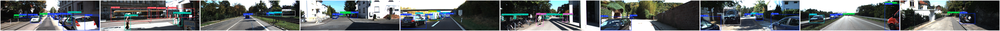

In [80]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

# Define the directory where the predictions are saved
prediction_dir = 'runs/detect/predict'

# List all images in the prediction directory
images = os.listdir(prediction_dir)

# Display up to 10 images with predictions
num_images_to_display = min(10, len(images))  # Ensure we don't exceed the number of available images
fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 100))  # Create a row of subplots

for i in range(num_images_to_display):
    img_path = os.path.join(prediction_dir, images[i])  # Get image path
    img = mpimg.imread(img_path)  # Load the image
    axes[i].imshow(img)  # Show image on the corresponding subplot
    axes[i].axis('off')  # Disable axis for the subplot

plt.tight_layout()  # Adjust spacing between images
plt.show()

